#welcome to the Solution for Food Classification Image Algorithm AI Test

### Instructions in the cell below 🔽

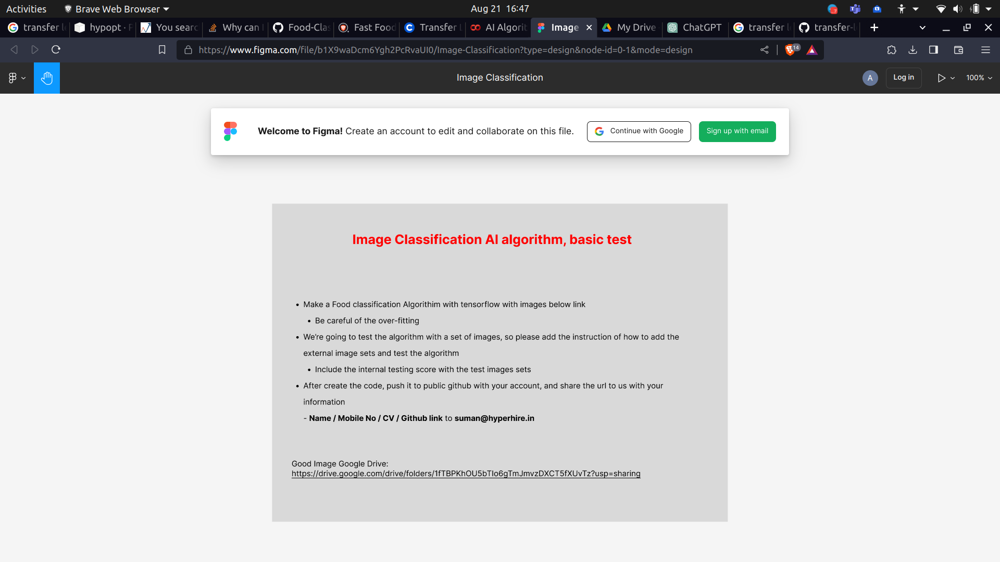

In [2]:
from IPython.display import Image

# Specify the path to the uploaded image
image_path = "/content/drive/MyDrive/Screenshot from 2023-08-21 16-47-33.png"  # Replace with the actual path of the uploaded image

# Display the image in the text cell
Image(image_path)
#🔽

### Let's check for the availability of a GPU and update our base directory

In [5]:
# Import necessary libraries
import numpy as np
import os
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt

# Set up GPU
device_name = tf.test.gpu_device_name()
if device_name != '/device:GPU:0':
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

# Mount Google Drive
# from google.colab import drive
# drive.mount('/content/drive')

# Update the base directory to point to the 'foodimage' folder in your Google Drive
base_dir = '/content/drive/MyDrive/Colab Notebooks/FoodImage'
# 🕺 it's available 👇

Found GPU at: /device:GPU:0


### Let's view various images in our FoodImage Folder and the distribution of the classes of our immages that informs our class balance, hence we opt for data augmentation technique

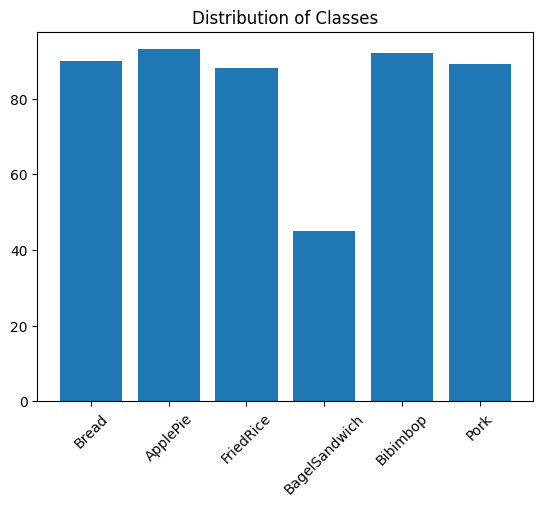

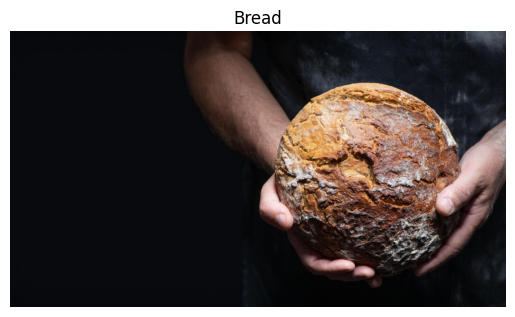

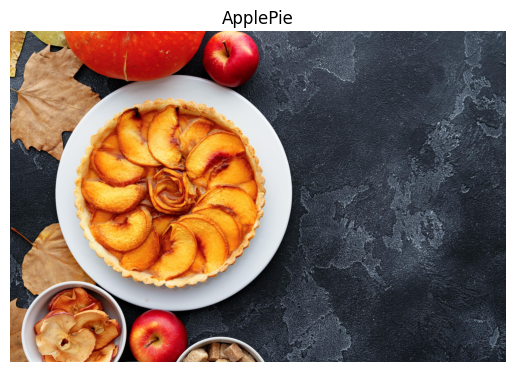

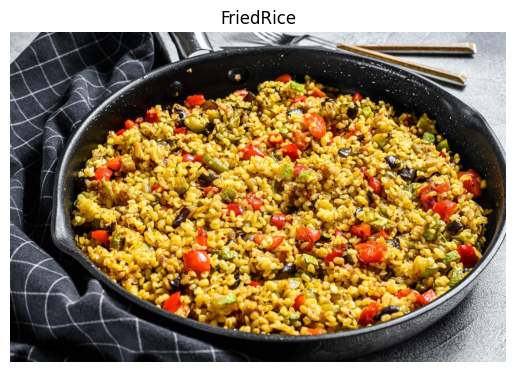

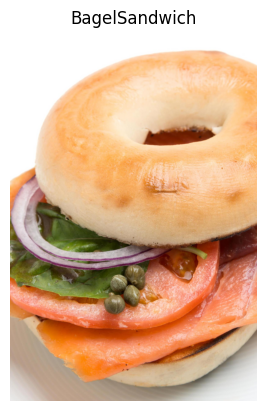

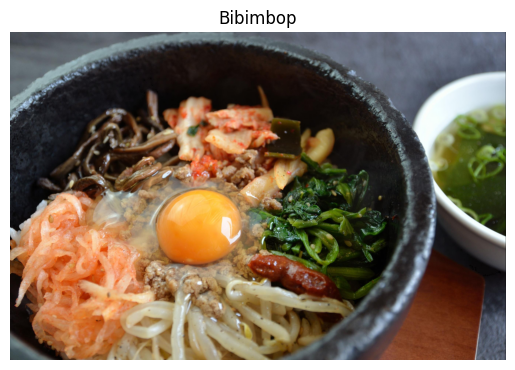

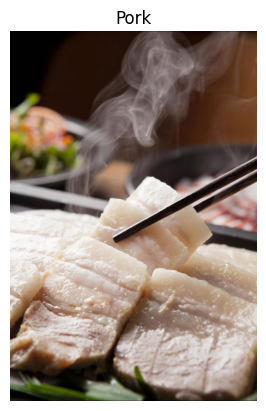

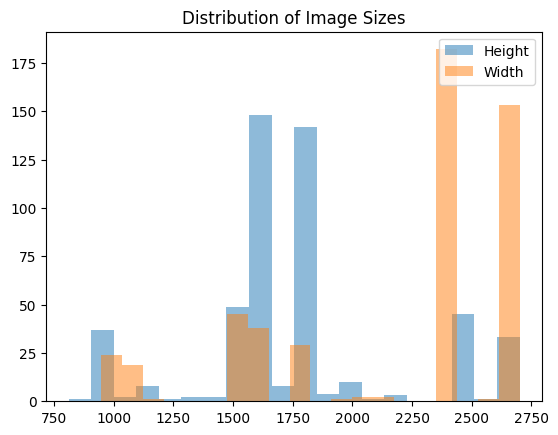

In [6]:
import matplotlib.pyplot as plt
import os

# Distribution of Classes
folders = [folder for folder in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, folder)) and not folder.startswith('.')]
class_counts = {}

for folder in folders:
    class_counts[folder] = len(os.listdir(os.path.join(base_dir, folder)))

plt.bar(class_counts.keys(), class_counts.values())
plt.title('Distribution of Classes')
plt.xticks(rotation=45)
plt.show()

# Sample Images
for folder in folders:
    sample_image = os.listdir(os.path.join(base_dir, folder))[0]
    img_path = os.path.join(base_dir, folder, sample_image)
    img = plt.imread(img_path)
    plt.imshow(img)
    plt.title(folder)
    plt.axis('off')
    plt.show()

# Image Sizes
heights = []
widths = []

for folder in folders:
    for image_name in os.listdir(os.path.join(base_dir, folder)):
        img_path = os.path.join(base_dir, folder, image_name)
        img = plt.imread(img_path)
        heights.append(img.shape[0])
        widths.append(img.shape[1])

plt.hist(heights, bins=20, alpha=0.5, label='Height')
plt.hist(widths, bins=20, alpha=0.5, label='Width')
plt.legend(loc='upper right')
plt.title('Distribution of Image Sizes')
plt.show()


### Above we find that Bagglesandwich is less represented,why, but there's solution 😃, Augment 🧰

### let's check the quamtity of the images indifferent labels to confirm below ⏬

In [7]:
import os
from google.colab import drive

# # Mount Google Drive
# drive.mount('/content/drive')

# Set the path to the 'foodimage' folder in your Google Drive
base_dir = '/content/drive/MyDrive/Colab Notebooks/FoodImage'

# List all the subdirectories (classes) in the 'foodimage' folder
folders = [folder for folder in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, folder)) and not folder.startswith('.')]

# Get the number of images in each class
class_counts = {}
for folder in folders:
    class_counts[folder] = len(os.listdir(os.path.join(base_dir, folder)))

# Print the number of images in each class
for class_name, count in class_counts.items():
    print(f"{class_name}: {count} images")

Bread: 90 images
ApplePie: 93 images
FriedRice: 88 images
BagelSandwich: 45 images
Bibimbop: 92 images
Pork: 89 images


## confirmed, 45 images for Baggle sandwich👆

### we check the total image count in the next 2 cells ⏬

In [8]:
datadir = '/content/drive/MyDrive/Colab Notebooks/FoodImage'

In [9]:
import os
from pathlib import Path

datadir = '/content/drive/MyDrive/Colab Notebooks/FoodImage'

# Calculate the total number of images in the dataset
data_dir = Path(datadir)
image_count = len(list(data_dir.glob('*/*.jpg')))
print("Total number of images:", image_count)


Total number of images: 497


### Let's proceed to feed our eyes with different images so you could be filled and forget the task at hand 😆, i am just a joker 🃏

In [10]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential

🤩 see 🍞 ⏬ , let's eat 🍽 :eat with PIL library 🤭

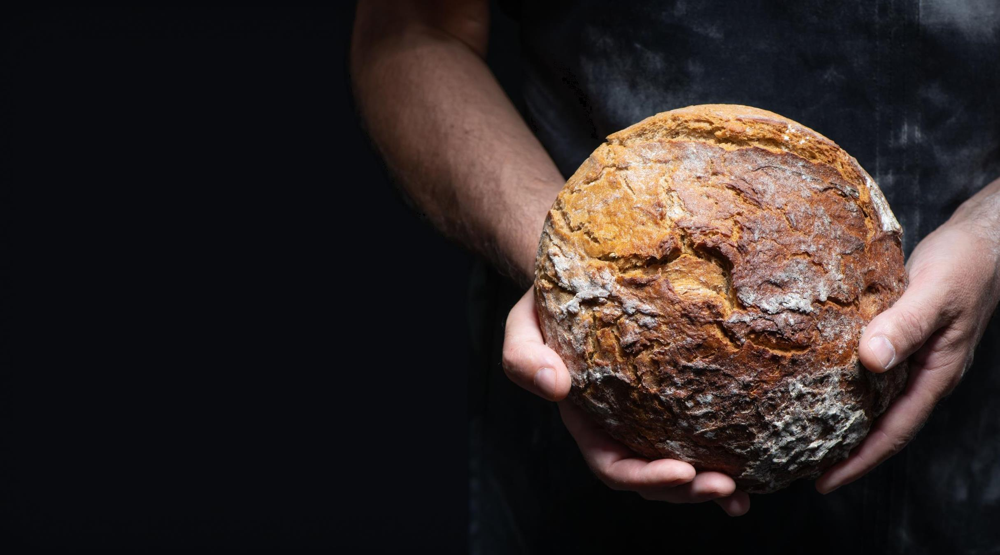

In [11]:
bread = list(data_dir.glob('Bread/*'))
PIL.Image.open(str(bread[0]))

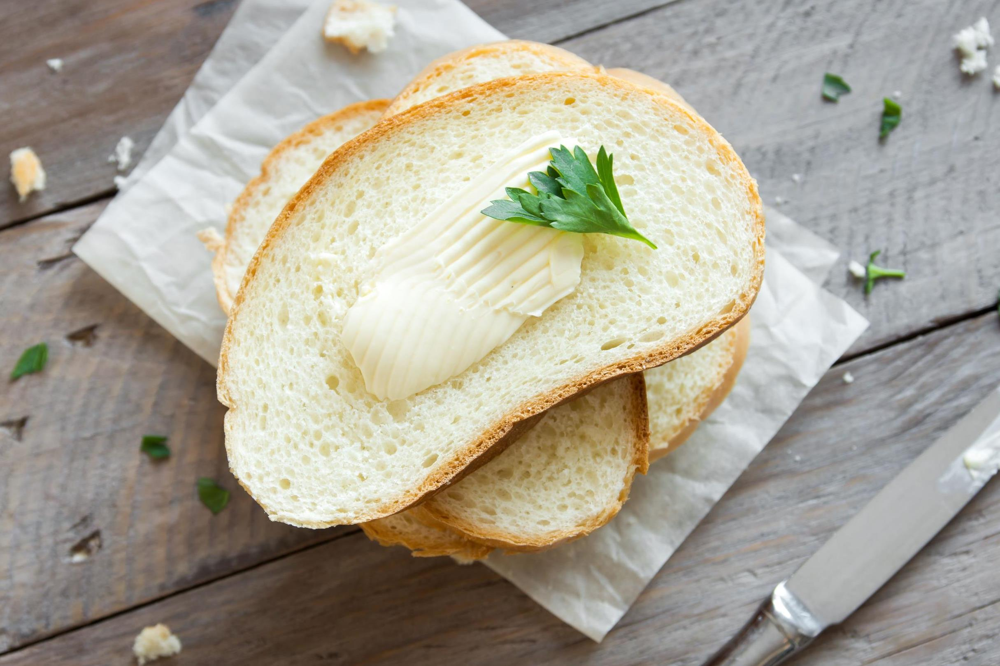

In [12]:
PIL.Image.open(str(bread[1]))

### Distribution of the image width and height in the end of the output 🈁

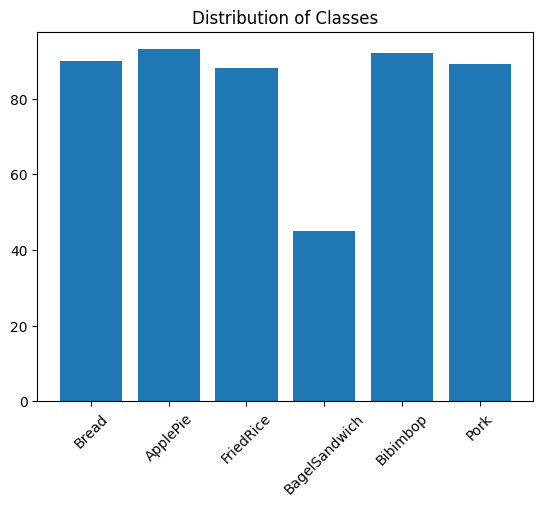

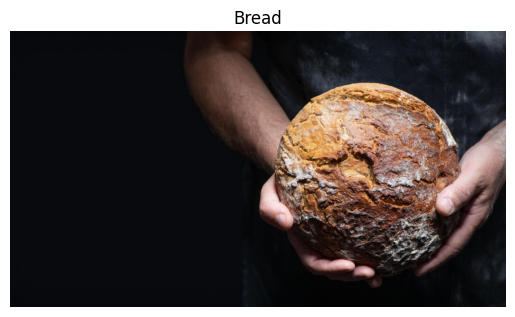

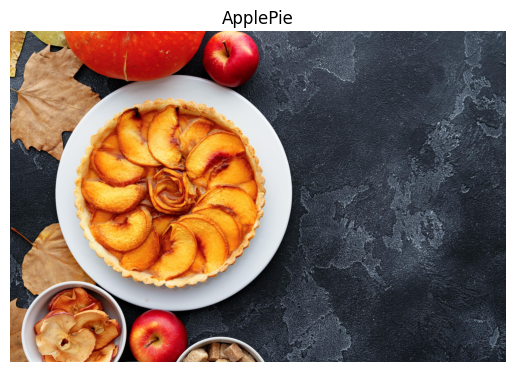

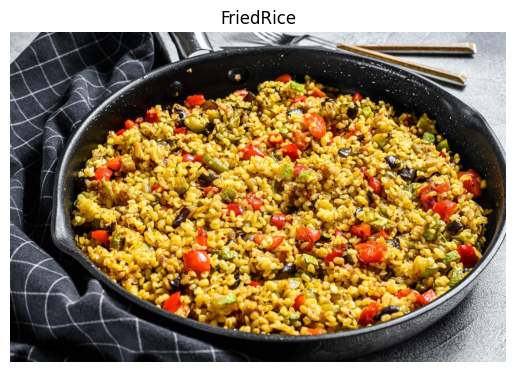

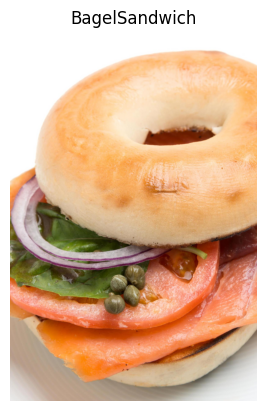

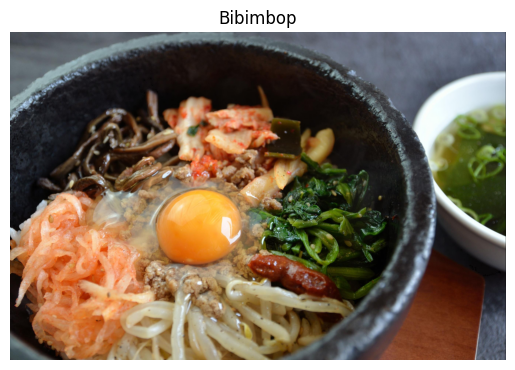

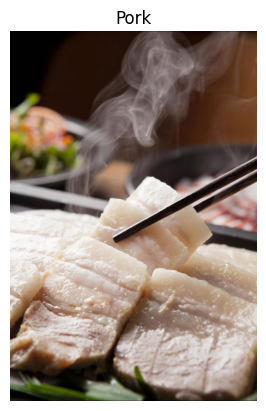

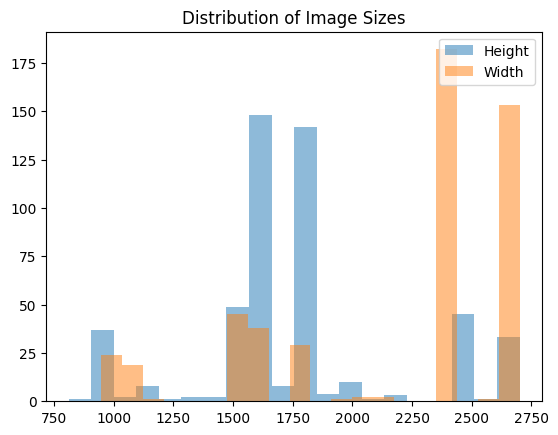

Heights: [1350, 1620, 1130, 1620, 1620, 2430, 1820, 1619, 2430, 1616, 1367, 1620, 1625, 1619, 2430, 1620, 1616, 1620, 1779, 2430, 1721, 1619, 1619, 1620, 1620, 1620, 2430, 1625, 1620, 1620, 1619, 1620, 1620, 1620, 1620, 1620, 1687, 1620, 1822, 1620, 1620, 1620, 1817, 1619, 1619, 1620, 2430, 1620, 1620, 1620, 1620, 2430, 1620, 1608, 1558, 1620, 1619, 1620, 2430, 1620, 1620, 1620, 1619, 1445, 1619, 1032, 1620, 1620, 1620, 1620, 812, 1609, 1530, 1254, 1619, 1620, 1731, 1620, 1619, 1761, 1856, 1523, 1620, 1620, 1619, 1613, 1615, 1620, 1620, 1620, 1800, 1800, 1800, 1800, 1800, 1800, 1799, 1800, 1800, 1800, 1800, 1800, 1800, 2700, 2700, 2700, 2700, 2700, 1800, 2700, 1788, 1788, 1788, 1799, 1800, 1800, 1795, 1795, 1802, 2700, 2700, 1800, 1800, 1800, 1800, 2152, 1979, 1795, 1799, 2700, 1678, 1800, 2700, 2025, 2700, 1800, 1800, 1799, 1800, 2700, 2700, 1800, 1800, 1800, 2700, 2025, 2025, 2700, 1856, 2700, 2700, 1800, 1800, 2700, 1799, 1797, 1799, 2700, 2700, 1799, 1801, 1800, 1799, 1800, 1799, 1

In [13]:
import matplotlib.pyplot as plt
import os
import csv

# Distribution of Classes
folders = [folder for folder in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, folder)) and not folder.startswith('.')]
class_counts = {}

for folder in folders:
    class_counts[folder] = len(os.listdir(os.path.join(base_dir, folder)))

plt.bar(class_counts.keys(), class_counts.values())
plt.title('Distribution of Classes')
plt.xticks(rotation=45)
plt.show()

# Sample Images
for folder in folders:
    sample_image = os.listdir(os.path.join(base_dir, folder))[0]
    img_path = os.path.join(base_dir, folder, sample_image)
    img = plt.imread(img_path)
    plt.imshow(img)
    plt.title(folder)
    plt.axis('off')
    plt.show()

# Image Sizes
heights = []
widths = []

for folder in folders:
    for image_name in os.listdir(os.path.join(base_dir, folder)):
        img_path = os.path.join(base_dir, folder, image_name)
        img = plt.imread(img_path)
        heights.append(img.shape[0])
        widths.append(img.shape[1])

plt.hist(heights, bins=20, alpha=0.5, label='Height')
plt.hist(widths, bins=20, alpha=0.5, label='Width')
plt.legend(loc='upper right')
plt.title('Distribution of Image Sizes')
plt.show()



# 1. Printing Directly:
print("Heights:", heights)
print("Widths:", widths)

# 2. Storing in a CSV File:
with open('image_sizes.csv', 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(["Folder", "Image Name", "Height", "Width"])

    for folder in folders:
        for image_name in os.listdir(os.path.join(base_dir, folder)):
            img_path = os.path.join(base_dir, folder, image_name)
            img = plt.imread(img_path)
            writer.writerow([folder, image_name, img.shape[0], img.shape[1]])


#Begin Image Processing 🔽 as an officeworker 🧑

In [14]:
import os
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

warnings.filterwarnings("ignore")
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from PIL import Image
from skimage.io import imread
import cv2

K.clear_session()

#### In summary, this code snippet ⏬ loads an image using Matplotlib, reshapes the image data into a two-dimensional matrix using NumPy, and then prints the dimensions of the reshaped matrix. This reshaping of the image data is often useful for various types of image processing and analysis tasks, as it simplifies the manipulation of pixel values and color channels.

In [15]:
img = plt.imread('/content/drive/MyDrive/Colab Notebooks/FoodImage/BagelSandwich/B020411XX_11162.jpg')
dims = np.shape(img)
matrix = np.reshape(img, (dims[0] * dims[1], dims[2]))
print(np.shape(matrix))

(3934170, 3)




```
# This code snippet 👇 visualizes the loaded image, prints its dimensions (height and width), displays the number of color channels, and provides information about the minimum and maximum color values present in the image. This information is helpful for understanding the image's size, color composition, and color intensity range.
```



Image shape ->  (2430, 1619)
Color channels ->  3
Min color depth : 0, Max color depth 255


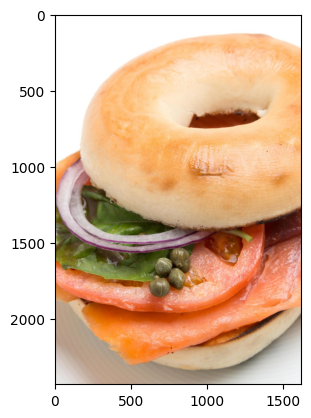

In [16]:
plt.imshow(img)
print("Image shape -> ",dims[:2])
print("Color channels -> ",dims[2])
print("Min color depth : {}, Max color depth {}".format(np.min(img),np.max(img)))

#### this code below creates three distribution plots (histograms) using Seaborn to visualize the distribution of pixel values across each color channel (red, green, and blue) in the image. The transparency settings (alpha) are used to control the opacity of each histogram, allowing for better visualization of overlapping data. The resulting plots provide insight into the color intensity distribution of the different color channels in the image.

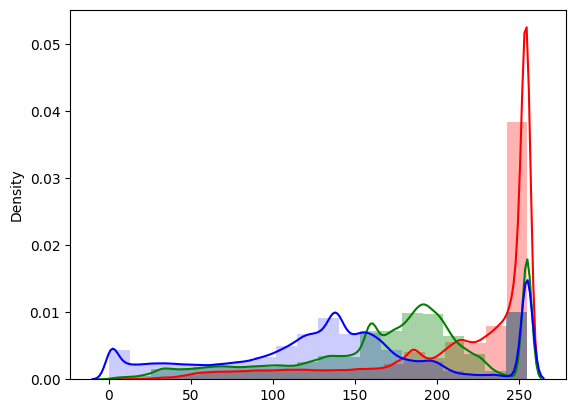

In [17]:
sns.distplot(matrix[:,0], bins=20,color="red",hist_kws=dict(alpha=0.3))
sns.distplot(matrix[:,1], bins=20,color="green",hist_kws=dict(alpha=0.35))
sns.distplot(matrix[:,2], bins=20,color="blue",hist_kws=dict(alpha=0.2))
plt.show()

#### This code creates a 2D histogram that visualizes the joint distribution of pixel values between the green and blue color channels of the image. The x-axis represents the green channel values, the y-axis represents the blue channel values, and the color intensity of each bin in the plot indicates the frequency or density of pixel values in that region of the color space. This type of visualization can help you understand the color relationships and patterns within the image.

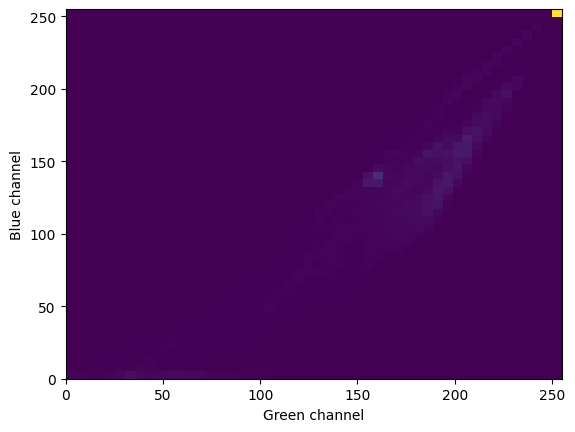

In [ ]:
_ = plt.hist2d(matrix[:,1], matrix[:,2], bins=(50,50))
plt.xlabel('Green channel')
plt.ylabel('Blue channel')
plt.show()

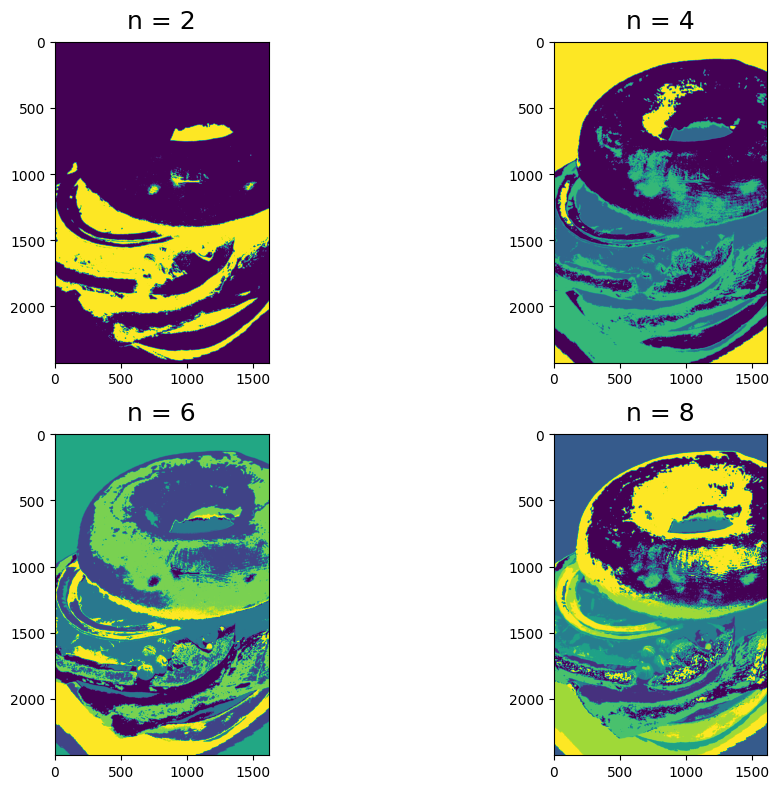

In [ ]:
from sklearn import cluster
n_vals=[2,4,6,8]
plt.figure(1, figsize=(12, 8))

for subplot,n in enumerate(n_vals):
    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    dims = np.shape(img)
    clustered_img = np.reshape(clustered, (dims[0], dims[1]))
    plt.subplot(2,2, subplot+1)
    plt.title("n = {}".format(n), pad = 10,size=18)
    plt.imshow(clustered_img)

plt.tight_layout()

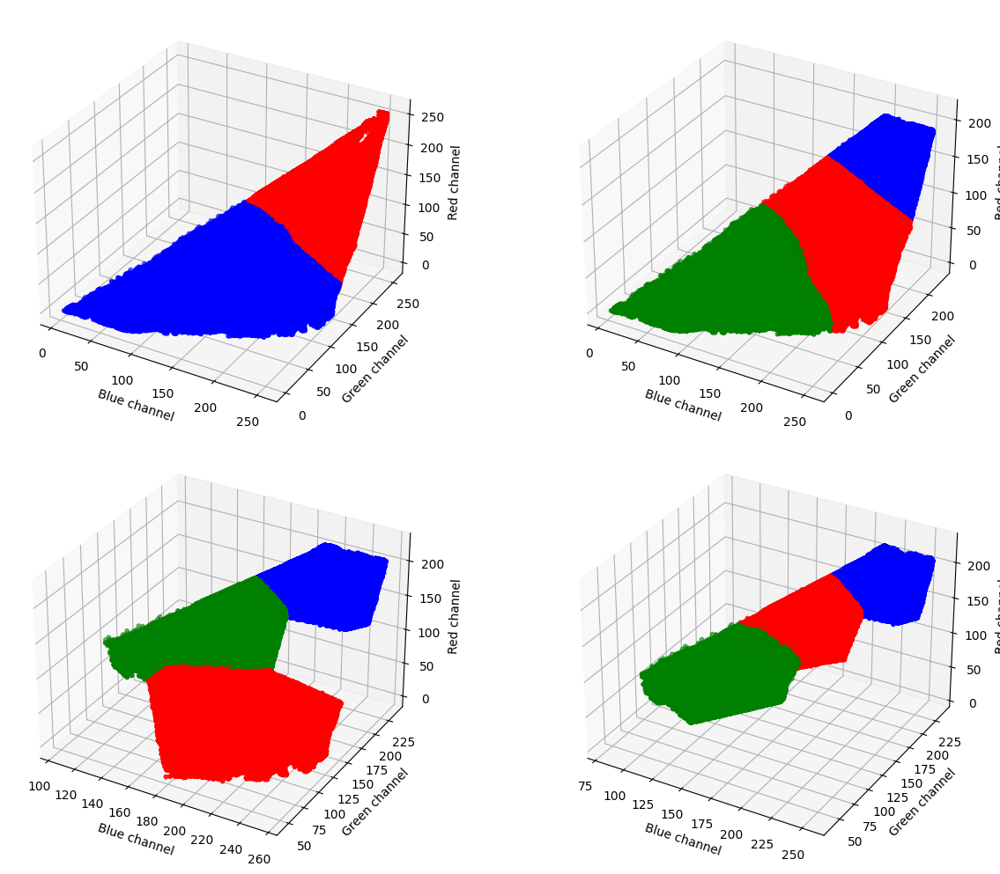

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig=plt.figure(figsize=(14,10))

ax = [fig.add_subplot(221, projection='3d'),
      fig.add_subplot(222, projection='3d'),
      fig.add_subplot(223, projection='3d'),
      fig.add_subplot(224, projection='3d')]

for plot_number,n in enumerate(n_vals):

    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    x1, y1, z1 = [np.where(clustered == x)[0] for x in [0, 1, 2]]

    plot_vals = [('r', x1),
                 ('b', y1),
                 ('g', z1),
                 ]

    for c, channel in plot_vals:
        x = matrix[channel, 0]
        y = matrix[channel, 1]
        z = matrix[channel, 2]
        ax[plot_number].scatter(x, y, z, c=c,s=10)

    ax[plot_number].set_xlabel('Blue channel')
    ax[plot_number].set_ylabel('Green channel')
    ax[plot_number].set_zlabel('Red channel')

plt.tight_layout()



```
# This code snippet  below performs normalization on the pixel values of an image and then displays the normalized image. The normalization operation scales the color values of each pixel to the range [0, 1], which can be useful for various image processing tasks such as enhancing contrast or preparing data for machine learning models that benefit from standardized input values. The resulting plot shows the image with normalized color values
```



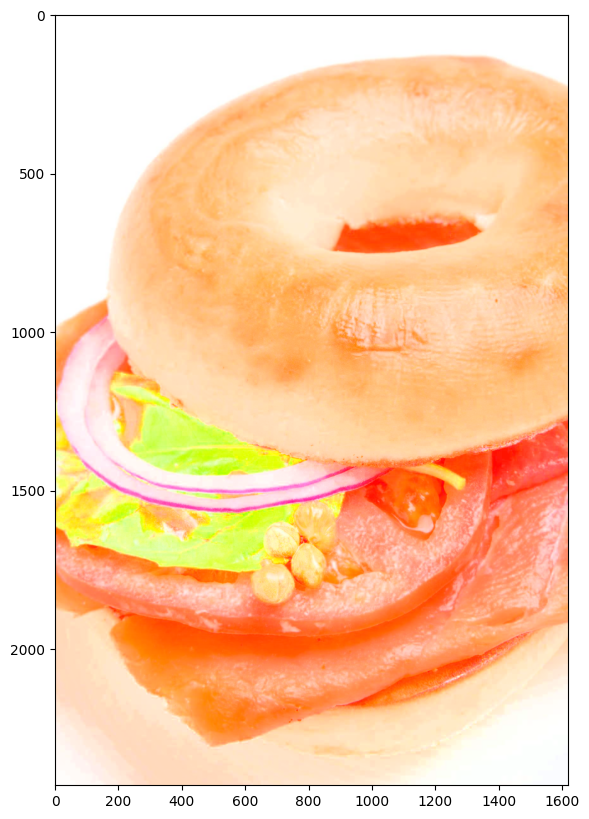

In [ ]:
bnorm = np.zeros_like(matrix, dtype=np.float32)
max_range = np.max(matrix, axis=1)
bnorm = matrix / np.vstack((max_range, max_range, max_range)).T
bnorm_img = np.reshape(bnorm, (dims[0],dims[1],dims[2]))
plt.figure(figsize=(8,10))
plt.imshow(bnorm_img)
plt.show()

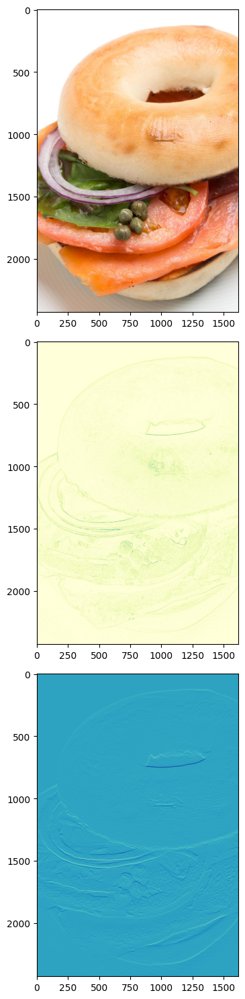

In [ ]:
import skimage
from skimage.feature import greycomatrix, greycoprops
from skimage.filters import sobel
from skimage.filters import sobel_h

plt.figure(1,figsize=(20,15))
cmap="YlGnBu"
plt.subplot(3,1,1)
plt.imshow(img)

plt.subplot(3,1,2)
plt.imshow(sobel(img[:,:,2]),cmap=cmap)

plt.subplot(3,1,3)
plt.imshow(sobel_h(img[:,:,1]), cmap=cmap)

plt.tight_layout()

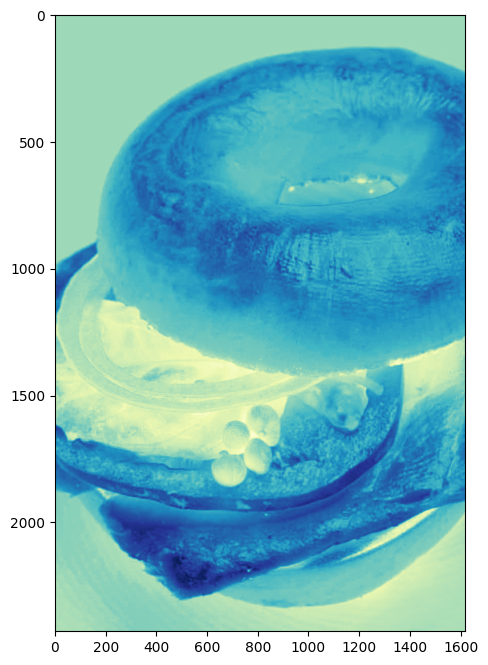

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(3)
pca.fit(matrix)
img_pca = pca.transform(matrix)
img_pca = np.reshape(img_pca, (dims[0], dims[1], dims[2]))

fig = plt.figure(figsize=(8, 8))
plt.imshow(img_pca[:,:,1], cmap=cmap)

#End of Image Preprocessing 🈁

#Visualization of the different food classes 👇

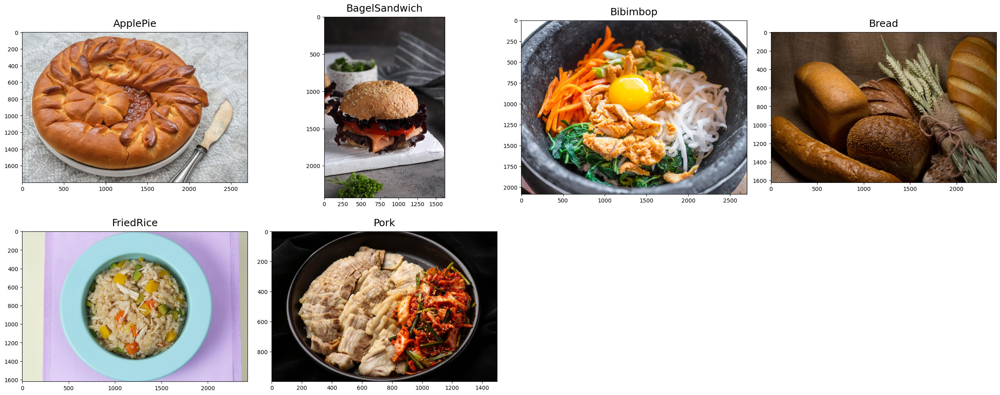

In [ ]:
import os
import matplotlib.pyplot as plt
import numpy as np

# Updated path to the newly created train directory
train_folder = "/content/drive/MyDrive/Colab Notebooks/train"

images = []

# Loop through each food class folder in the train directory
for food_folder in sorted(os.listdir(train_folder)):
    food_items = os.listdir(os.path.join(train_folder, food_folder))

    # Randomly select an image from the current food class
    food_selected = np.random.choice(food_items)
    images.append(os.path.join(train_folder, food_folder, food_selected))

# Visualization
fig = plt.figure(1, figsize=(25, 25))

for subplot, image_ in enumerate(images):
    category = image_.split('/')[-2]
    imgs = plt.imread(image_)
    fig = plt.subplot(5, 4, subplot+1)
    fig.set_title(category, pad=10, size=18)
    plt.imshow(imgs)

plt.tight_layout()
plt.show()


#End of Visualization ⬆

# Begin Work ⬇

### Impoerting the Necessary Libraries for training using Pytorch but the recommended library is Tensorflow and keras which will be done at the latter stage. it's time for seriousness 🙍

In [20]:
from __future__ import print_function, division

import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy

### Detecting a Gpu from pytorch's library? below

In [21]:

PATH = "/content/drive/MyDrive/Colab Notebooks/foodmain"

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# make sure my GPU is detected.
print(device)

cuda:0


### Data transforms 👇 are used in machine learning and deep learning pipelines to preprocess and augment the input data before it is used for training or validation. In the context of image data, like in our provided code, data transforms are applied to images to prepare them for training or evaluation by a neural network.

In [22]:
data_transforms = {
    'Train': transforms.Compose([
        transforms.RandomResizedCrop(224),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'Valid': transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}



```
`# This code sets up data loaders  👇 for both training and validation datasets. Data loaders are essential for efficiently feeding data into machine learning models during training and evaluation. By using data loaders, you can easily iterate over batches of data and shuffle the data within each epoch, which helps prevent the model from memorizing the order of the data and improves generalization. Additionally, the dataset sizes are calculated for both training and validation, which can be useful for tracking progress during training and validation phases.`
```



In [23]:
image_datasets = {
    x: datasets.ImageFolder(os.path.join(PATH, x),
                            data_transforms[x]) for x in ['Train', 'Valid']
}
dataloaders = {
    x: torch.utils.data.DataLoader(image_datasets[x],
                                   batch_size=32,
                                   shuffle=True,
                                ) for x in ['Train', 'Valid']
}
dataset_sizes = {x: len(image_datasets[x]) for x in ['Train', 'Valid']}



```
`# Thisclass_names variable is assigned the list of class names extracted from the 'Train' dataset using the image_datasets['Train'].classes attribute. This line of code helps you obtain the list of classes or categories that your machine learning model will learn to distinguish based on the images in the 'Train' dataset.`
```



In [24]:
class_names = image_datasets['Train'].classes
print(class_names)

['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']


#### createa function to display image

In [25]:
# create a function image show

def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

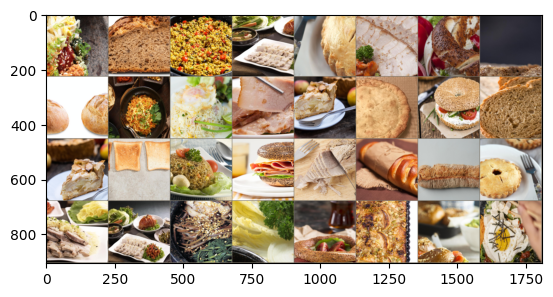

In [26]:
# Get a batch of training data
inputs, classes = next(iter(dataloaders['Train']))

# Make a grid from batch
out = torchvision.utils.make_grid(inputs)

imshow(out)

##### The train_model function takes a PyTorch model, a loss criterion, an optimizer, a learning rate scheduler, and the number of training epochs as inputs. It trains and evaluates the model on a dataset with a training-validation split, updating the model's weights based on the optimization process. It iterates through the specified number of epochs, tracking and printing the loss and accuracy for both the training and validation phases. The best model weights are deep copied during validation if the validation accuracy improves, and at the end of training, the function returns the model with the best validation accuracy. The function helps automate the process of training and evaluating a model while tracking the best performing version of the model based on validation accuracy.

In [ ]:
def train_model(model, criterion, optimizer, scheduler, num_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print(f'Epoch {epoch}/{num_epochs - 1}')
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['Train', 'Valid']:
            if phase == 'Train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'Train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'Train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'Train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print(f'{phase} Loss: {epoch_loss:.4f} Acc: {epoch_acc:.4f}')

            # deep copy the model
            if phase == 'Valid' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print(f'Training complete in {time_elapsed // 60:.0f}m {time_elapsed % 60:.0f}s')
    print(f'Best Valid Acc: {best_acc:4f}')

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

[link text](https://paperswithcode.com/methods/category/convolutional-neural-networks)

##### This code snippet ⏬ demonstrates the creation and setup of a convolutional neural network (CNN) model using PyTorch's ResNet-18 architecture, setting up loss functions and optimizers for training, and applying a learning rate scheduler

In [ ]:
model_1 = models.resnet18(pretrained=True)
num_ftrs = model_1.fc.in_features
# Here the size of each output sample is set to 2.
# Alternatively, it can be generalized to nn.Linear(num_ftrs, len(class_names)).
model_1.fc = nn.Linear(num_ftrs, len(class_names))

model_1 = model_1.to(device)

criterion = nn.CrossEntropyLoss()

# Observe that all parameters are being optimized
optimizer_sgd = optim.SGD(model_1.parameters(), lr=0.001, momentum=0.9)
optimizer_adam = optim.Adam(model_1.parameters(), lr=0.001)

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_adam, step_size=7, gamma=0.1)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 225MB/s]


### Training begins 🔽

In [ ]:
model_resnetft = train_model(model_1, criterion, optimizer_adam, exp_lr_scheduler,
                       num_epochs=15)

Epoch 0/14
----------
Train Loss: 1.2210 Acc: 0.6010
Valid Loss: 6.9679 Acc: 0.3469

Epoch 1/14
----------
Train Loss: 1.1332 Acc: 0.6616
Valid Loss: 3.1104 Acc: 0.6327

Epoch 2/14
----------
Train Loss: 0.7444 Acc: 0.7475
Valid Loss: 1.2770 Acc: 0.6531

Epoch 3/14
----------
Train Loss: 0.7030 Acc: 0.7525
Valid Loss: 0.8584 Acc: 0.7143

Epoch 4/14
----------
Train Loss: 0.5439 Acc: 0.7955
Valid Loss: 1.0135 Acc: 0.6939

Epoch 5/14
----------
Train Loss: 0.4671 Acc: 0.8460
Valid Loss: 0.5284 Acc: 0.7755

Epoch 6/14
----------
Train Loss: 0.4508 Acc: 0.8384
Valid Loss: 2.1938 Acc: 0.6122

Epoch 7/14
----------
Train Loss: 0.3444 Acc: 0.8864
Valid Loss: 0.3905 Acc: 0.8776

Epoch 8/14
----------
Train Loss: 0.3526 Acc: 0.8737
Valid Loss: 0.2281 Acc: 0.8980

Epoch 9/14
----------
Train Loss: 0.2359 Acc: 0.9167
Valid Loss: 0.1840 Acc: 0.9592

Epoch 10/14
----------
Train Loss: 0.2564 Acc: 0.9091
Valid Loss: 0.1525 Acc: 0.9388

Epoch 11/14
----------
Train Loss: 0.2547 Acc: 0.9141
Valid Loss

### Visualize the model performance

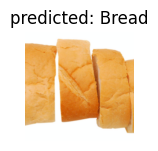

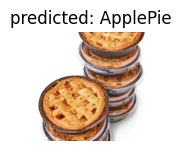

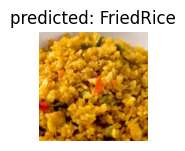

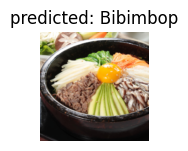

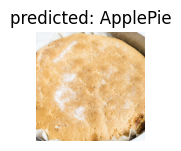

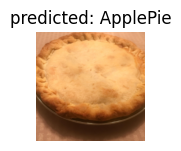

In [ ]:
def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['Valid']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title(f'predicted: {class_names[preds[j]]}')
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)


# Visualize model
visualize_model(model_1)

### Testing the prediction which shows 💯 correctnes 😀 but wait we are expected to use Tensorflow 😏. Let's continue  ⏯

ApplePie: 1.00
BagelSandwich: 0.00
Bibimbop: 0.00
Bread: 0.00
FriedRice: 0.00
Pork: 0.00


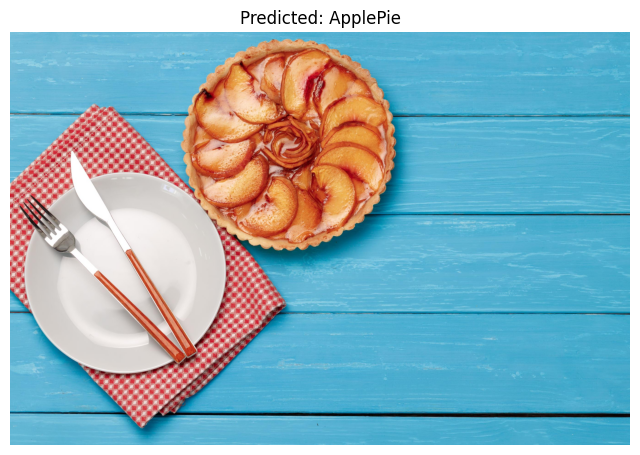

In [ ]:
import torch
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from PIL import Image

def visualize_single_image(model, image_path, class_names):
    was_training = model.training
    model.eval()

    # Load and preprocess the image
    img = Image.open(image_path)
    preprocess = transforms.Compose([
        transforms.Resize(256),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    img_tensor = preprocess(img).unsqueeze(0)

    # Move the tensor to the same device as the model
    device = next(model.parameters()).device  # Get the device of the model
    img_tensor = img_tensor.to(device)  # Move the tensor to that device

    with torch.no_grad():
        outputs = model(img_tensor)
        _, preds = torch.max(outputs, 1)
        confidence = torch.nn.functional.softmax(outputs, dim=1)[0]  # Get the confidence scores

        # Display the image and prediction results
        plt.figure(figsize=(8, 8))
        plt.imshow(img)
        plt.axis('off')
        plt.title(f'Predicted: {class_names[preds[0]]}')

        for i, (class_name, conf) in enumerate(zip(class_names, confidence.cpu())):
            print(f"{class_name}: {conf:.2f}")

        model.train(mode=was_training)


# Specify the path to the image you want to visualize
image_path = "/content/drive/MyDrive/Colab Notebooks/foodmain/test/ApplePie/A020511XX_02579.jpg"  # Update with the actual path

# Specify the class names
class_names = image_datasets['Train'].classes  # Update with the actual class names

# Visualize the single image
visualize_single_image(model_1, image_path, class_names)


In [1]:
!pip install hypopt

In [32]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt;
import random
# Importing sklearn libraries
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, accuracy_score

# Importing hypopt library for grid search
from hypopt import GridSearch

# Importing Keras libraries
from keras.utils import np_utils
from keras.models import Sequential
from keras.applications import VGG16
from keras.applications import imagenet_utils
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.utils import load_img, img_to_array
from keras.layers import Dense, Conv2D, MaxPooling2D
from keras.layers import Dropout, Flatten, GlobalAveragePooling2D

import warnings
warnings.filterwarnings('ignore')

This os for creating the dataset into train, val and test in 70-20-10% respectively without NOT adding any external image as instructed
```
`# import os
import shutil

base_dir = '/content/drive/MyDrive/Colab Notebooks/FoodImage'
dest_dir = '/content/drive/MyDrive/Colab Notebooks/food-11'

# Ensure the destination directories exist
os.makedirs(dest_dir, exist_ok=True)

splits = ['training', 'validation', 'test']
for split in splits:
    os.makedirs(os.path.join(dest_dir, split), exist_ok=True)

# Define the class mapping
class_map = {'ApplePie': 0, 'BagelSandwich': 1, 'Bibimbop': 2, 'Bread': 3, 'FriedRice': 4, 'Pork': 5}

# Copy the images to the new structure with the desired split
for class_name, class_idx in class_map.items():
    class_folder = os.path.join(base_dir, class_name)
    all_images = os.listdir(class_folder)

    # Shuffle the images to ensure random distribution
    random.shuffle(all_images)

    # Split the images
    train_images = all_images[:int(0.7 * len(all_images))]
    val_images = all_images[int(0.7 * len(all_images)):int(0.9 * len(all_images))]
    test_images = all_images[int(0.9 * len(all_images)):]

    for img in train_images:
        shutil.copy(os.path.join(class_folder, img), os.path.join(dest_dir, 'training', f"{class_idx}_{img}"))

    for img in val_images:
        shutil.copy(os.path.join(class_folder, img), os.path.join(dest_dir, 'validation', f"{class_idx}_{img}"))

    for img in test_images:
        shutil.copy(os.path.join(class_folder, img), os.path.join(dest_dir, 'test', f"{class_idx}_{img}"))
`
```



#### I checked if the 3 different folders represent the various folder labels

In [11]:
import os

dest_dir = '/content/drive/MyDrive/Colab Notebooks/food-11'
splits = ['training', 'validation', 'test']

def extract_classes_from_filenames(filenames):
    # Extract class indices from filenames and return as a set
    return set([int(filename.split('_')[0]) for filename in filenames])

for split in splits:
    split_dir = os.path.join(dest_dir, split)
    all_files = os.listdir(split_dir)
    unique_classes = extract_classes_from_filenames(all_files)

    print(f"In '{split}' directory, unique classes present are: {unique_classes}")


In 'training' directory, unique classes present are: {0, 1, 2, 3, 4, 5}
In 'validation' directory, unique classes present are: {0, 1, 2, 3, 4, 5}
In 'test' directory, unique classes present are: {0, 1, 2, 3, 4, 5}


I Was correct, as you can see 👆 {0, 1, 2, 3, 4, 5}






### This code snippet is generating lists containing file paths to images in different directories. It appears to be setting up file paths for training, validation, and test images in a food classification dataset. 💚

In [27]:
train = [os.path.join("/content/drive/MyDrive/Colab Notebooks/food-11/training",img) for img in os.listdir("/content/drive/MyDrive/Colab Notebooks/food-11/training")]
val = [os.path.join("/content/drive/MyDrive/Colab Notebooks/food-11/validation",img) for img in os.listdir("/content/drive/MyDrive/Colab Notebooks/food-11/validation")]
test = [os.path.join("/content/drive/MyDrive/Colab Notebooks/food-11/test",img) for img in os.listdir("/content/drive/MyDrive/Colab Notebooks/food-11/test")]

### check the Length (quantity of images) in various paths

In [28]:
len(train),len(val),len(test)

(346, 100, 52)

### Listing the first 5 contents in training folder

In [29]:
train[0:5]

['/content/drive/MyDrive/Colab Notebooks/food-11/training/0_A020511XX_02694.jpg',
 '/content/drive/MyDrive/Colab Notebooks/food-11/training/0_A020511XX_02733.jpg',
 '/content/drive/MyDrive/Colab Notebooks/food-11/training/0_A020511XX_02601.jpg',
 '/content/drive/MyDrive/Colab Notebooks/food-11/training/0_A020511XX_02698.jpg',
 '/content/drive/MyDrive/Colab Notebooks/food-11/training/0_A020511XX_02616.jpg']

### This code ⏬ extracts class labels from the file names of images in the training, validation, and test datasets. The class labels are encoded as integers and represent the categories to which each image belongs. This information is essential for associating images with their corresponding class labels during the training, validation, and testing phases of a machine learning or deep learning model.

In [30]:
train_y = [int(img.split("/")[-1].split("_")[0]) for img in train]
val_y = [int(img.split("/")[-1].split("_")[0]) for img in val]
test_y = [int(img.split("/")[-1].split("_")[0]) for img in test]

#### This code ⬇ converts the integer class labels into one-hot encoded categorical labels, which are binary vectors representing the class memberships of each sample. Each vector has a length equal to the num_classes, where only the corresponding class index is marked as 1, and the rest are marked as 0. This representation is often used as the target output for training machine learning models in multi-class classification tasks

In [33]:
num_classes = 6
y_train = np_utils.to_categorical(train_y, num_classes)
y_val = np_utils.to_categorical(val_y, num_classes)
y_test = np_utils.to_categorical(test_y, num_classes)



```
# This is a representation of the first five training sample labels below in their one-hot encoded format. Each row corresponds to a different training sample, and each column corresponds to a different class. The value 1.0 indicates that the corresponding class is present in the sample, while the value 0.0 indicates that the class is not prese
```



In [34]:
y_train[0:5]

array([[1., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.]], dtype=float32)

### Train class distribution for our Tensorflow training

Training data available in 6 classes
[66, 31, 64, 62, 61, 62]


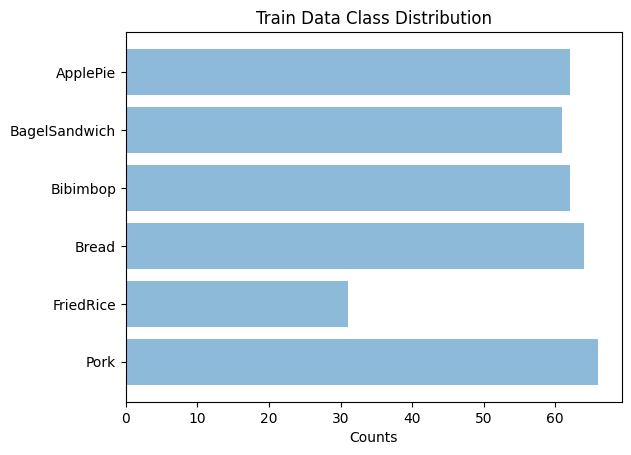

In [ ]:
print("Training data available in 6 classes")
print([train_y.count(i) for i in range(0,6)])

food_classes = ('Pork','FriedRice','Bread','Bibimbop','BagelSandwich','ApplePie')

y_pos = np.arange(len(food_classes))
counts = [train_y.count(i) for i in range(0,6)]

plt.barh(y_pos, counts, align='center', alpha=0.5)
plt.yticks(y_pos, food_classes)
plt.xlabel('Counts')
plt.title('Train Data Class Distribution')

plt.show()

### FriedRice is small, we will create data augmentation to resolve the issue

### validation data below

In [35]:
print("Validation data available in 6 classes")
[val_y.count(i) for i in range(0,6)]

Validation data available in 6 classes


[18, 9, 18, 19, 18, 18]

Test data representation

In [ ]:
print("Test data available in 6 classes")
[test_y.count(i) for i in range(0,6)]

Test data available in 6 classes


[10, 5, 10, 9, 9, 9]

### showing different images with the target image size of [224,224] below

In [36]:
def show_imgs(X):
    plt.figure(figsize=(8, 8))
    k = 0
    for i in range(0,4):
        for j in range(0,4):
            image = load_img(train[k], target_size=(224, 224))
            plt.subplot2grid((4,4),(i,j))
            plt.imshow(image)
            k = k+1
    # show the plot
    plt.show()

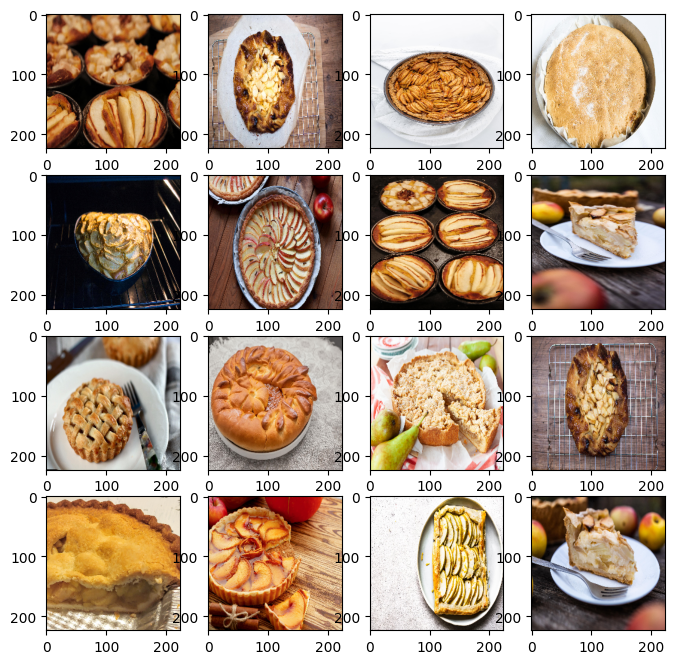

In [37]:
show_imgs(train)

### Viewing the model summary below and the architecture of a VGG16 network.  [VGG16](https://www.mathworks.com/help/deeplearning/ref/vgg16.html)

[INFO] loading network...


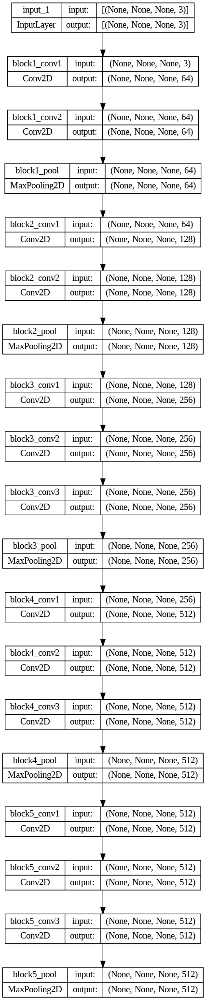

In [38]:
# load the VGG16 network and initialize the label encoder
print("[INFO] loading network...")
model = VGG16(weights="imagenet", include_top=False)
#model.summary()
tf.keras.utils.plot_model(model, show_shapes=True)

#####  This function below takes a list of image file paths, preprocesses the images, passes them through a pre-trained CNN model, and extracts the feature representations. These representations can be used as input to other machine learning models or for further analysis. This is often referred to as "feature extraction" or "transfer learning," where a pre-trained model is utilized to extract meaningful features from images without training a new model from scratch.

In [39]:
def create_features(dataset, pre_model):

    x_scratch = []

    # loop over the images
    for imagePath in dataset:

        # load the input image and image is resized to 224x224 pixels
        image = load_img(imagePath, target_size=(224, 224))
        image = img_to_array(image)

        # preprocess the image by (1) expanding the dimensions and
        # (2) subtracting the mean RGB pixel intensity from the
        # ImageNet dataset
        image = np.expand_dims(image, axis=0)
        image = imagenet_utils.preprocess_input(image)

        # add the image to the batch
        x_scratch.append(image)

    x = np.vstack(x_scratch)
    features = pre_model.predict(x, batch_size=32)
    features_flatten = features.reshape((features.shape[0], 7 * 7 * 512))
    return x, features, features_flatten



```
# This provided code below ⬇ uses the create_features function to generate feature representations for images in the training, validation, and test datasets using a pre-trained model.
```



In [40]:
train_x, train_features, train_features_flatten = create_features(train, model)
val_x, val_features, val_features_flatten = create_features(val, model)
test_x, test_features, test_features_flatten = create_features(test, model)

2/2 [==============================] - 3s 3s/step


The provided code below 👇 prints the shapes of the arrays containing the preprocessed images (train_x, val_x, test_x), feature representations (train_features, val_features, test_features), and flattened feature representations (train_features_flatten, val_features_flatten, test_features_flatten).


In [41]:
print(train_x.shape, train_features.shape, train_features_flatten.shape)
print(val_x.shape, val_features.shape, val_features_flatten.shape)
print(test_x.shape, test_features.shape, test_features_flatten.shape)

(346, 224, 224, 3) (346, 7, 7, 512) (346, 25088)
(100, 224, 224, 3) (100, 7, 7, 512) (100, 25088)
(52, 224, 224, 3) (52, 7, 7, 512) (52, 25088)


### Regularization: Consider adding L2 regularization if you notice overfitting.

In [42]:
from tensorflow.keras.regularizers import l2


In [43]:
reg_strength = 0.01  # This is a hyperparameter you can tune

# Creating a checkpointer
checkpointer = ModelCheckpoint(filepath='scratchmodellll.best.hdf5',
                               verbose=1,save_best_only=True)

model = Sequential()

# Convolutional layers
model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

# Flatten layer
model.add(Flatten())

# Dense layers with L2 regularization
model.add(Dense(512, activation='relu', kernel_regularizer=l2(reg_strength)))
model.add(Dropout(0.5))
model.add(Dense(6, activation='softmax', kernel_regularizer=l2(reg_strength)))

model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 26, 26, 128)      0

### Compiling and training from scratch for comparison and iteratioons

In [44]:
from tensorflow.keras.optimizers import Adam

# Define the optimizer with a custom learning rate
optimizer = Adam(learning_rate=0.0001)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

#Fitting the model on the train data and labels.
history = model.fit(train_x, y_train,
          batch_size=8, epochs=20,
          verbose=1, callbacks=[checkpointer],
          validation_data=(val_x, y_val), shuffle=True)


Epoch 1/20
44/44 [==============================] - ETA: 0s - loss: 72.1823 - accuracy: 0.2370
Epoch 1: val_loss improved from inf to 13.61958, saving model to scratchmodellll.best.hdf5
44/44 [==============================] - 11s 119ms/step - loss: 72.1823 - accuracy: 0.2370 - val_loss: 13.6196 - val_accuracy: 0.3400
Epoch 2/20
43/44 [============================>.] - ETA: 0s - loss: 9.8652 - accuracy: 0.5116
Epoch 2: val_loss improved from 13.61958 to 9.38130, saving model to scratchmodellll.best.hdf5
44/44 [==============================] - 6s 133ms/step - loss: 9.8592 - accuracy: 0.5116 - val_loss: 9.3813 - val_accuracy: 0.4400
Epoch 3/20
43/44 [============================>.] - ETA: 0s - loss: 8.1675 - accuracy: 0.8372
Epoch 3: val_loss improved from 9.38130 to 9.27672, saving model to scratchmodellll.best.hdf5
44/44 [==============================] - 5s 116ms/step - loss: 8.1672 - accuracy: 0.8382 - val_loss: 9.2767 - val_accuracy: 0.4900
Epoch 4/20
43/44 [=======================

#### From the above epochs, i anounce it's sad 😭 ..  😓

Advice: ⬇

Regularization: While L2 regularization can help prevent overfitting, if the penalty is too strong, it can hinder the model's ability to learn. You might want to experiment with a smaller value for the regularization strength.

Data Augmentation: You've already applied data augmentation, which is great. You can experiment with different augmentation techniques or adjust the existing ones to see if it helps improve validation performance.

Early Stopping: Consider adding an EarlyStopping callback. This stops training once the validation loss stops improving, preventing potential overfitting and saving computational resources.

Dropout: Consider adding dropout layers in your model. Dropout is another regularization technique where random subsets of neurons are turned off during training, forcing the network to learn redundant representations.

Learning Rate: Experiment with different learning rates. Sometimes, a smaller learning rate can help the model converge to a better solution, especially when regularization is applied.

Model Complexity: Your model might be too complex for the amount of data you have. Consider reducing the number of layers or the number of neurons in each layer.

Gather More Data: If possible, try to gather more training data or use data augmentation techniques to artificially increase the size of your training dataset. More data can help improve the model's generalization.

#### But there's  hope🙏 😸

### 2nd Iteration, Training from the scratch below

In [56]:
# Creating a checkpointer
checkpointer = ModelCheckpoint(filepath='scratchmodel.best.hdf5',
                               verbose=1,save_best_only=True)

# Building up a Sequential model
model_scratch = Sequential()
model_scratch.add(Conv2D(32, (3, 3), activation='relu',input_shape = train_x.shape[1:]))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))

model_scratch.add(Conv2D(64, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))

model_scratch.add(Conv2D(64, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))

model_scratch.add(Conv2D(128, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))

model_scratch.add(Conv2D(256, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))

model_scratch.add(Conv2D(512, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))

model_scratch.add(GlobalAveragePooling2D())
model_scratch.add(Dense(512, activation='relu'))
model_scratch.add(Dense(6, activation='softmax'))
model_scratch.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_11 (Conv2D)          (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 111, 111, 32)     0         
 g2D)                                                            
                                                                 
 conv2d_12 (Conv2D)          (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 54, 54, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_13 (Conv2D)          (None, 52, 52, 64)        36928     
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 26, 26, 64)      

### let's compile and train again

In [57]:
model_scratch.compile(loss='categorical_crossentropy', optimizer='adam',
              metrics=['accuracy'])

#Fitting the model on the train data and labels.
history = model_scratch.fit(train_x, y_train,
          batch_size=8, epochs=20,
          verbose=1, callbacks=[checkpointer],
          validation_data=(val_x, y_val), shuffle=True)

Epoch 1/20
42/44 [===========================>..] - ETA: 0s - loss: 4.6258 - accuracy: 0.1964
Epoch 1: val_loss improved from inf to 1.88569, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 9s 49ms/step - loss: 4.5401 - accuracy: 0.1965 - val_loss: 1.8857 - val_accuracy: 0.2600
Epoch 2/20
43/44 [============================>.] - ETA: 0s - loss: 1.6586 - accuracy: 0.3663
Epoch 2: val_loss improved from 1.88569 to 1.53705, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 2s 34ms/step - loss: 1.6578 - accuracy: 0.3642 - val_loss: 1.5370 - val_accuracy: 0.4000
Epoch 3/20
41/44 [==========================>...] - ETA: 0s - loss: 1.3969 - accuracy: 0.3963
Epoch 3: val_loss did not improve from 1.53705
44/44 [==============================] - 1s 21ms/step - loss: 1.3816 - accuracy: 0.4017 - val_loss: 1.5830 - val_accuracy: 0.4400
Epoch 4/20
43/44 [============================>.] - ETA: 0s - loss: 1.2340 - accuracy: 0.4971
Epoch 4: 

### Plotting the Train and Validation accuracy, Loss including

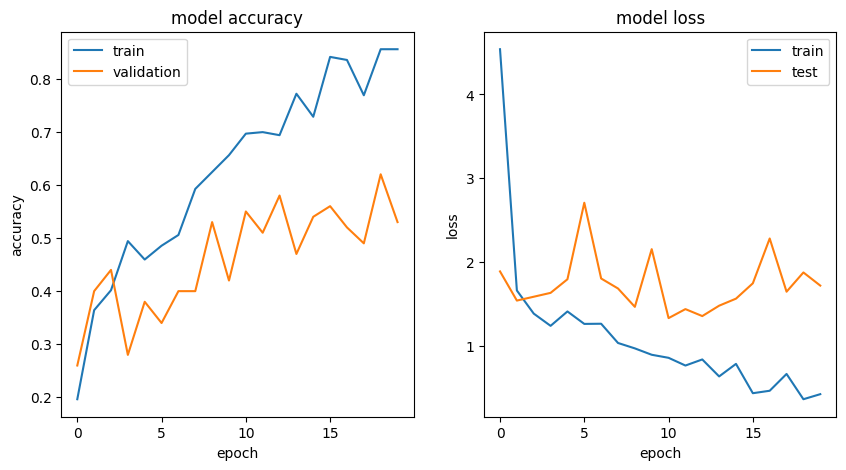

In [58]:
fig = plt.figure(figsize=(10,5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

### Test scores on test data is 36%

In [59]:
preds = np.argmax(model_scratch.predict(test_x), axis=1)
print("\nAccuracy on Test Data: ", accuracy_score(test_y, preds))
print("\nNumber of correctly identified imgaes: ",
      accuracy_score(test_y, preds, normalize=False),"\n")
confusion_matrix(test_y, preds, labels=range(0,6))

2/2 [==============================] - 1s 177ms/step

Accuracy on Test Data:  0.36538461538461536

Number of correctly identified imgaes:  19 



array([[3, 0, 0, 3, 4, 0],
       [0, 0, 1, 3, 1, 0],
       [1, 0, 2, 0, 7, 0],
       [1, 0, 0, 6, 1, 1],
       [1, 0, 1, 2, 4, 1],
       [1, 0, 0, 1, 3, 4]])

#### Implementing transfer Learning
- The provided code ⏬ defines and summarizes a simple neural network model for transfer learning on top of the precomputed feature representations generated using the pre-trained model

In [60]:
model_transfer = Sequential()
model_transfer.add(GlobalAveragePooling2D(input_shape=train_features.shape[1:]))
model_transfer.add(Dropout(0.3))
model_transfer.add(Dense(100, activation='relu'))
model_transfer.add(Dense(6, activation='softmax'))
model_transfer.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_4   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dropout_2 (Dropout)         (None, 512)               0         
                                                                 
 dense_10 (Dense)            (None, 100)               51300     
                                                                 
 dense_11 (Dense)            (None, 6)                 606       
                                                                 
Total params: 51,906
Trainable params: 51,906
Non-trainable params: 0
_________________________________________________________________


In [52]:
###Let's compile and see the Performance

### implememnting another 3rd iteration to retrain ⏬

In [61]:
model_transfer.compile(loss='categorical_crossentropy', optimizer='adam',
              metrics=['accuracy'])
history = model_transfer.fit(train_features, y_train, batch_size=8, epochs=15,
          validation_data=(val_features, y_val), callbacks=[checkpointer],
          verbose=1, shuffle=True)

Epoch 1/15
43/44 [============================>.] - ETA: 0s - loss: 5.3570 - accuracy: 0.4012
Epoch 1: val_loss improved from 1.32754 to 1.26943, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 1s 10ms/step - loss: 5.3978 - accuracy: 0.3988 - val_loss: 1.2694 - val_accuracy: 0.7600
Epoch 2/15
32/44 [====================>.........] - ETA: 0s - loss: 1.4433 - accuracy: 0.6797
Epoch 2: val_loss improved from 1.26943 to 0.85240, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 0s 6ms/step - loss: 1.3870 - accuracy: 0.6994 - val_loss: 0.8524 - val_accuracy: 0.8200
Epoch 3/15
39/44 [=========================>....] - ETA: 0s - loss: 0.8935 - accuracy: 0.7756
Epoch 3: val_loss improved from 0.85240 to 0.66171, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 0s 7ms/step - loss: 0.8641 - accuracy: 0.7861 - val_loss: 0.6617 - val_accuracy: 0.8700
Epoch 4/15
32/44 [====================>.........] - ETA: 

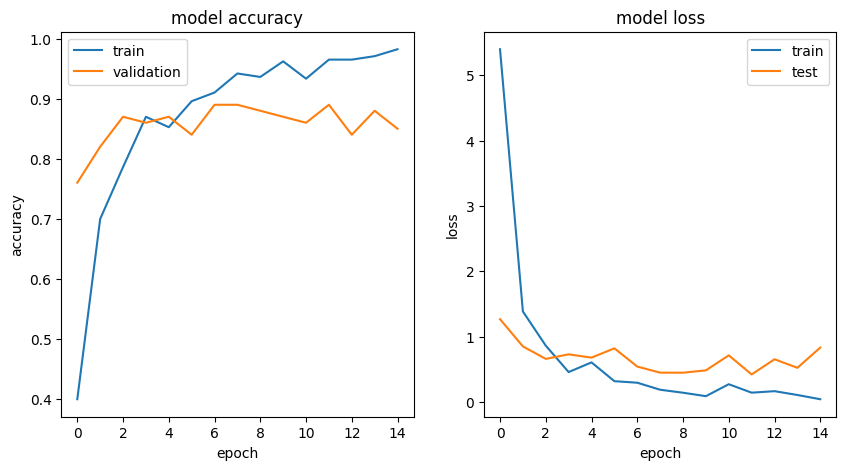

In [62]:
fig = plt.figure(figsize=(10,5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

### Test score on test set is 88% 👇

In [63]:
preds = np.argmax(model_transfer.predict(test_features), axis=1)
print("\nAccuracy on Test Data: ", accuracy_score(test_y, preds))
print("\nNumber of correctly identified imgaes: ",
      accuracy_score(test_y, preds, normalize=False),"\n")
confusion_matrix(test_y, preds, labels=range(0,6))

2/2 [==============================] - 0s 7ms/step

Accuracy on Test Data:  0.8846153846153846

Number of correctly identified imgaes:  46 



array([[10,  0,  0,  0,  0,  0],
       [ 0,  4,  0,  0,  0,  1],
       [ 0,  0, 10,  0,  0,  0],
       [ 1,  0,  0,  8,  0,  0],
       [ 0,  0,  1,  0,  8,  0],
       [ 1,  0,  2,  0,  0,  6]])

#### Implementing another 4th iteration below ⬇

In [ ]:
model_transfer.compile(loss='categorical_crossentropy', optimizer='adam',
              metrics=['accuracy'])
history = model_transfer.fit(train_features, y_train, batch_size=8, epochs=15,
          validation_data=(val_features, y_val), callbacks=[checkpointer],
          verbose=1, shuffle=True)

Epoch 1/15
42/44 [===========================>..] - ETA: 0s - loss: 5.8384 - accuracy: 0.4048
Epoch 1: val_loss did not improve from 1.16402
44/44 [==============================] - 2s 13ms/step - loss: 5.8103 - accuracy: 0.4017 - val_loss: 1.2616 - val_accuracy: 0.7300
Epoch 2/15
35/44 [======================>.......] - ETA: 0s - loss: 1.7104 - accuracy: 0.7286
Epoch 2: val_loss improved from 1.16402 to 0.67237, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 0s 8ms/step - loss: 1.5778 - accuracy: 0.7457 - val_loss: 0.6724 - val_accuracy: 0.8700
Epoch 3/15
43/44 [============================>.] - ETA: 0s - loss: 0.9372 - accuracy: 0.8314
Epoch 3: val_loss improved from 0.67237 to 0.49751, saving model to scratchmodel.best.hdf5
44/44 [==============================] - 0s 9ms/step - loss: 0.9318 - accuracy: 0.8324 - val_loss: 0.4975 - val_accuracy: 0.9000
Epoch 4/15
36/44 [=======================>......] - ETA: 0s - loss: 0.6300 - accuracy: 0.8715
Epoch 4

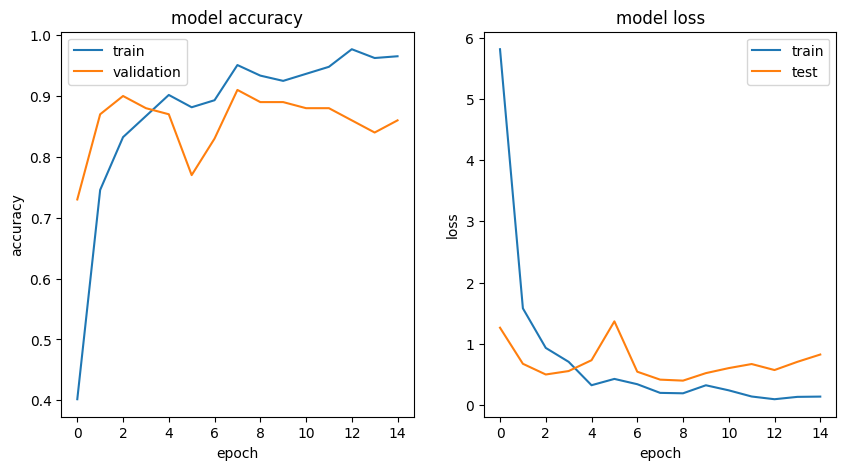

In [ ]:
fig = plt.figure(figsize=(10,5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

### Test scores below is 90% , correctly identifies 47 images out of 52 images 🔽

In [ ]:
preds = np.argmax(model_transfer.predict(test_features), axis=1)
print("\nAccuracy on Test Data: ", accuracy_score(test_y, preds))
print("\nNumber of correctly identified imgaes: ",
      accuracy_score(test_y, preds, normalize=False),"\n")
confusion_matrix(test_y, preds, labels=range(0,6))

2/2 [==============================] - 0s 6ms/step

Accuracy on Test Data:  0.9038461538461539

Number of correctly identified imgaes:  47 



array([[10,  0,  0,  0,  0,  0],
       [ 1,  3,  0,  0,  0,  1],
       [ 0,  0, 10,  0,  0,  0],
       [ 1,  0,  0,  8,  0,  0],
       [ 0,  0,  0,  0,  9,  0],
       [ 1,  0,  0,  1,  0,  7]])

### implementing another iteration of transfer learning below

In [ ]:
model_transfer = Sequential()
model_transfer.add(GlobalAveragePooling2D(input_shape=train_features.shape[1:]))
model_transfer.add(Dropout(0.3))
model_transfer.add(Dense(50, activation='relu'))
model_transfer.add(Dense(6, activation='softmax'))
model_transfer.summary()

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 global_average_pooling2d_11  (None, 512)              0         
  (GlobalAveragePooling2D)                                       
                                                                 
 dropout_9 (Dropout)         (None, 512)               0         
                                                                 
 dense_22 (Dense)            (None, 50)                25650     
                                                                 
 dense_23 (Dense)            (None, 6)                 306       
                                                                 
Total params: 25,956
Trainable params: 25,956
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model_transfer.compile(loss='categorical_crossentropy', optimizer='adam',
              metrics=['accuracy'])
history = model_transfer.fit(train_features, y_train, batch_size=8, epochs=25,
          validation_data=(val_features, y_val), callbacks=[checkpointer],
          verbose=1, shuffle=True)

Epoch 1/25
41/44 [==========================>...] - ETA: 0s - loss: 5.6125 - accuracy: 0.3780
Epoch 1: val_loss did not improve from 0.39737
44/44 [==============================] - 1s 10ms/step - loss: 5.3993 - accuracy: 0.3873 - val_loss: 1.3501 - val_accuracy: 0.6700
Epoch 2/25
44/44 [==============================] - ETA: 0s - loss: 1.7776 - accuracy: 0.6647
Epoch 2: val_loss did not improve from 0.39737
44/44 [==============================] - 0s 6ms/step - loss: 1.7776 - accuracy: 0.6647 - val_loss: 0.8362 - val_accuracy: 0.7900
Epoch 3/25
43/44 [============================>.] - ETA: 0s - loss: 1.2140 - accuracy: 0.7297
Epoch 3: val_loss did not improve from 0.39737
44/44 [==============================] - 0s 5ms/step - loss: 1.2076 - accuracy: 0.7312 - val_loss: 0.7261 - val_accuracy: 0.8000
Epoch 4/25
44/44 [==============================] - ETA: 0s - loss: 0.7969 - accuracy: 0.7717
Epoch 4: val_loss did not improve from 0.39737
44/44 [==============================] - 0s 6ms/

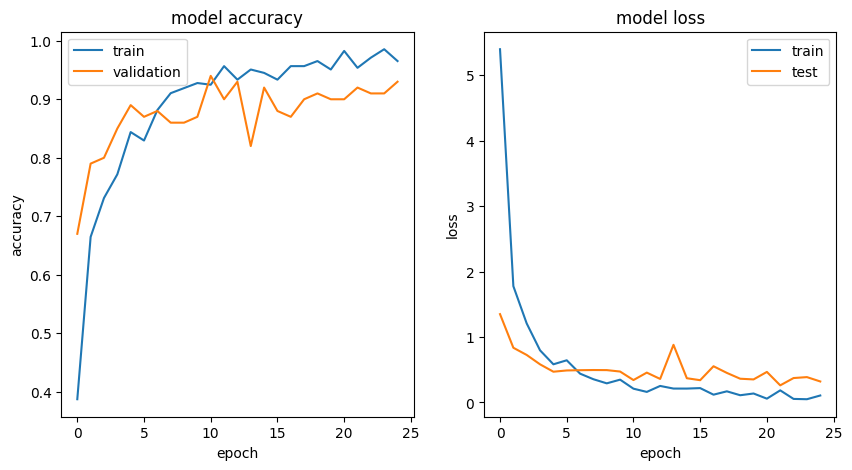

In [ ]:
fig = plt.figure(figsize=(10,5))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')

plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper right')
plt.show()

#### Test scores of 92% , correctly identifies 48 images out of 52 correctly 🕺 😀

In [ ]:
preds = np.argmax(model_transfer.predict(test_features), axis=1)
print("\nAccuracy on Test Data: ", accuracy_score(test_y, preds))
print("\nNumber of correctly identified imgaes: ",
      accuracy_score(test_y, preds, normalize=False),"\n")
confusion_matrix(test_y, preds, labels=range(0,6))

2/2 [==============================] - 0s 7ms/step

Accuracy on Test Data:  0.9230769230769231

Number of correctly identified imgaes:  48 



array([[10,  0,  0,  0,  0,  0],
       [ 0,  4,  0,  0,  0,  1],
       [ 0,  0, 10,  0,  0,  0],
       [ 0,  0,  0,  9,  0,  0],
       [ 0,  0,  0,  0,  9,  0],
       [ 1,  0,  1,  1,  0,  6]])

### implementing Data augmentation

In [15]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define data augmentation
datagen_train = ImageDataGenerator(
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Fit the augmentation to your data
datagen_train.fit(train_x)


In [18]:
from tensorflow.keras.layers import Dropout

# Building up a Sequential model with dropout
checkpointer = ModelCheckpoint(filepath='1scratchmodel.best.hdf5',
                               verbose=1,save_best_only=True)

model_scratch = Sequential()
model_scratch.add(Conv2D(32, (3, 3), activation='relu',input_shape = train_x.shape[1:]))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))
model_scratch.add(Dropout(0.25))

model_scratch.add(Conv2D(64, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))
model_scratch.add(Dropout(0.25))

model_scratch.add(Conv2D(64, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))
model_scratch.add(Dropout(0.25))

model_scratch.add(Conv2D(128, (3, 3), activation='relu'))
model_scratch.add(MaxPooling2D(pool_size=(2, 2)))
model_scratch.add(Dropout(0.25))

model_scratch.add(GlobalAveragePooling2D())
model_scratch.add(Dense(64, activation='relu'))
model_scratch.add(Dropout(0.5))
model_scratch.add(Dense(6, activation='softmax'))
model_scratch.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 111, 111, 32)     0         
 2D)                                                             
                                                                 
 dropout_5 (Dropout)         (None, 111, 111, 32)      0         
                                                                 
 conv2d_5 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 54, 54, 64)       

In [19]:
# Compile the model
model_scratch.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model using data augmentation
history = model_scratch.fit(datagen_train.flow(train_x, y_train, batch_size=8),
                            epochs=20, verbose=1, callbacks=[checkpointer],
                            validation_data=(val_x, y_val), shuffle=True)


Epoch 1/20
44/44 [==============================] - ETA: 0s - loss: 9.1572 - accuracy: 0.1821
Epoch 1: val_loss improved from inf to 1.79103, saving model to 1scratchmodel.best.hdf5
44/44 [==============================] - 13s 117ms/step - loss: 9.1572 - accuracy: 0.1821 - val_loss: 1.7910 - val_accuracy: 0.1700
Epoch 2/20
44/44 [==============================] - ETA: 0s - loss: 1.7582 - accuracy: 0.2197
Epoch 2: val_loss improved from 1.79103 to 1.78831, saving model to 1scratchmodel.best.hdf5
44/44 [==============================] - 6s 136ms/step - loss: 1.7582 - accuracy: 0.2197 - val_loss: 1.7883 - val_accuracy: 0.1900
Epoch 3/20
44/44 [==============================] - ETA: 0s - loss: 1.7559 - accuracy: 0.2283
Epoch 3: val_loss improved from 1.78831 to 1.76868, saving model to 1scratchmodel.best.hdf5
44/44 [==============================] - 4s 99ms/step - loss: 1.7559 - accuracy: 0.2283 - val_loss: 1.7687 - val_accuracy: 0.2700
Epoch 4/20
44/44 [==============================] - E

### Test scores is 32% , don't loose hope

In [24]:

class_map = {'ApplePie': 0, 'BagelSandwich': 1, 'Bibimbop': 2, 'Bread': 3, 'FriedRice': 4, 'Pork': 5}

from tensorflow.keras.utils import load_img, img_to_array
from keras.utils import np_utils
import numpy as np

# Load and preprocess the test data
test_images = []
test_labels = []

test_dir = "/content/drive/MyDrive/Colab Notebooks/food-11/test"

for img_name in os.listdir(test_dir):
    img_path = os.path.join(test_dir, img_name)
    img = load_img(img_path, target_size=(224, 224))
    img_array = img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = imagenet_utils.preprocess_input(img_array)
    test_images.append(img_array)

    # Extracting the class label from the image name
    class_idx = int(img_name.split("_")[0])
    test_labels.append(class_idx)

test_images = np.vstack(test_images)
test_labels = np.array(test_labels)
test_labels = np_utils.to_categorical(test_labels, 6)

# Evaluate the model
loss, accuracy = model_scratch.evaluate(test_images, test_labels)
print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")



2/2 [==============================] - 0s 406ms/step - loss: 1.6600 - accuracy: 0.3269
Test Loss: 1.6599605083465576
Test Accuracy: 0.32692307233810425


In [3]:
import numpy as np
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator


In [48]:
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(224, 224, 3))


In [49]:
for layer in base_model.layers:
    layer.trainable = False


In [28]:
model = Sequential([
    base_model,
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),
    Dense(256, activation='relu'),
    Dropout(0.5),
    Dense(6, activation='softmax')  # Assuming 6 classes
])


In [50]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])


In [51]:
datagen = ImageDataGenerator(
    rotation_range=20,
    zoom_range=0.15,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.15,
    horizontal_flip=True,
    fill_mode="nearest")



In [33]:
history = model.fit(datagen.flow(train_x, y_train, batch_size=32),
                    validation_data=(val_x, y_val),
                    epochs=20,
                    callbacks=[ModelCheckpoint('vgg19_finetuned.h5', save_best_only=True)])


Epoch 1/20
11/11 [==============================] - 9s 589ms/step - loss: 23.0243 - accuracy: 0.2110 - val_loss: 6.3580 - val_accuracy: 0.5100
Epoch 2/20
11/11 [==============================] - 6s 505ms/step - loss: 16.3577 - accuracy: 0.2890 - val_loss: 2.9318 - val_accuracy: 0.6200
Epoch 3/20
11/11 [==============================] - 7s 640ms/step - loss: 10.6755 - accuracy: 0.4075 - val_loss: 1.9810 - val_accuracy: 0.7100
Epoch 4/20
11/11 [==============================] - 5s 441ms/step - loss: 8.4003 - accuracy: 0.4277 - val_loss: 2.0827 - val_accuracy: 0.7200
Epoch 5/20
11/11 [==============================] - 6s 524ms/step - loss: 6.8057 - accuracy: 0.5405 - val_loss: 2.1981 - val_accuracy: 0.7500
Epoch 6/20
11/11 [==============================] - 6s 496ms/step - loss: 7.5073 - accuracy: 0.4913 - val_loss: 1.4731 - val_accuracy: 0.8200
Epoch 7/20
11/11 [==============================] - 7s 626ms/step - loss: 4.9324 - accuracy: 0.5491 - val_loss: 1.3801 - val_accuracy: 0.8000
Epo

### Test scores is 88%

In [37]:
loss, accuracy = model.evaluate(test_x, y_test)
print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")


2/2 [==============================] - 0s 145ms/step - loss: 1.2256 - accuracy: 0.8846
Test Loss: 1.225589632987976
Test Accuracy: 0.8846153616905212


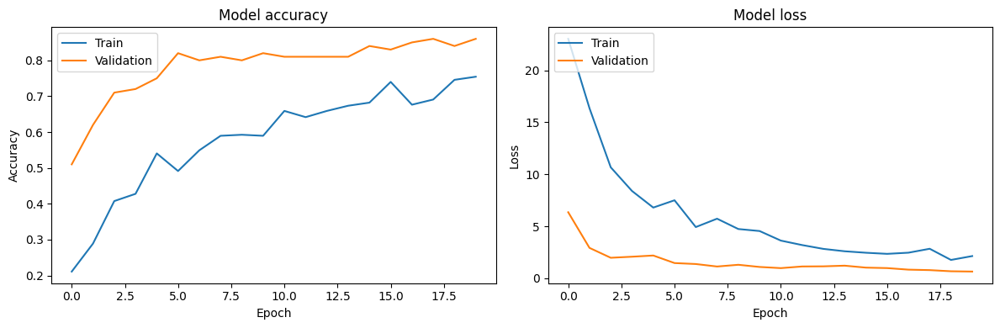

In [35]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()


4/4 [==============================] - 1s 156ms/step


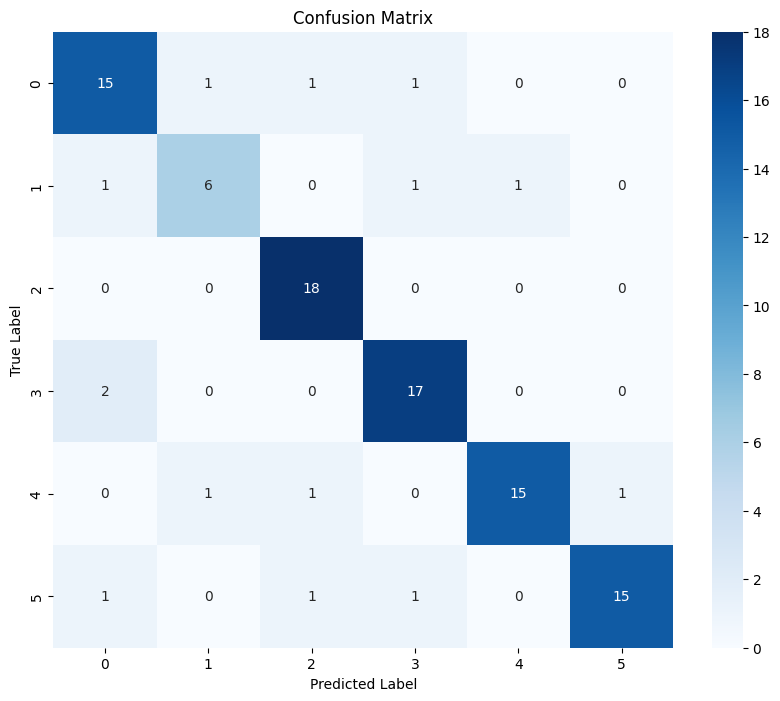

In [36]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

# Predict the values from the validation dataset
y_pred = model.predict(val_x)
y_pred_classes = np.argmax(y_pred, axis=1)
y_true = np.argmax(y_val, axis=1)

# Compute the confusion matrix
confusion_mtx = confusion_matrix(y_true, y_pred_classes)

# Plot the heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_mtx, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()


#### implementing another iteration to obtain a better performance.

In [40]:
import os
from tensorflow.keras.preprocessing.image import img_to_array, load_img
import numpy as np

# Path to the test directory
test_dir = '/content/drive/MyDrive/Colab Notebooks/food-11/test'

# List all image paths in the test directory
test_image_paths = [os.path.join(test_dir, img_name) for img_name in os.listdir(test_dir)]

# Load and preprocess the test images
test_images = []
for img_path in test_image_paths:
    img = load_img(img_path, target_size=(224, 224))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = img / 255.0  # Rescale
    test_images.append(img)

# Convert to a single numpy array
test_images = np.vstack(test_images)

# Extract true labels from the filenames
test_labels = [int(img_path.split("/")[-1].split("_")[0]) for img_path in test_image_paths]
test_labels = np_utils.to_categorical(test_labels, 6)  # Convert to one-hot encoding

# Evaluate the model
loss, accuracy = model.evaluate(test_images, test_labels)

print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy*100:.2f}%")


2/2 [==============================] - 0s 151ms/step - loss: 1.6653 - accuracy: 0.3846
Test Loss: 1.665266513824463
Test Accuracy: 38.46%


1/1 [==============================] - 1s 1s/step


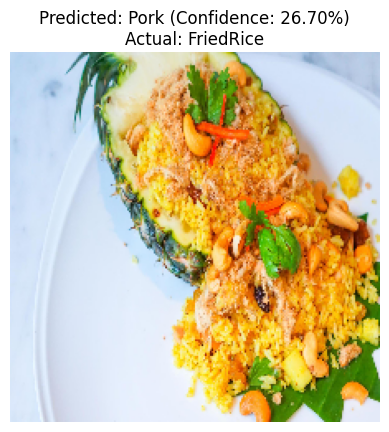

In [41]:
import random
import matplotlib.pyplot as plt

# Randomly select an image from the test directory
random_img_path = random.choice(test_image_paths)

# Load and preprocess the image
img = load_img(random_img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = img_array / 255.0  # Rescale

# Make a prediction
predictions = model.predict(img_array)
predicted_class = np.argmax(predictions)
confidence = predictions[0][predicted_class]

# Extract the actual label from the filename
actual_label = int(random_img_path.split("/")[-1].split("_")[0])

# Map class indices to class names
class_names = ['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']

# Display the results
plt.imshow(img)
plt.title(f"Predicted: {class_names[predicted_class]} (Confidence: {confidence*100:.2f}%)\nActual: {class_names[actual_label]}")
plt.axis('off')
plt.show()


1/1 [==============================] - 0s 98ms/step


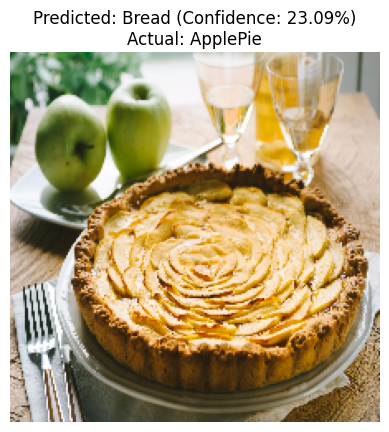

In [42]:
import random
import matplotlib.pyplot as plt

# Randomly select an image from the test directory
random_img_path = random.choice(test_image_paths)

# Load and preprocess the image
img = load_img(random_img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = img_array / 255.0  # Rescale

# Make a prediction
predictions = model.predict(img_array)
predicted_class = np.argmax(predictions)
confidence = predictions[0][predicted_class]

# Extract the actual label from the filename
actual_label = int(random_img_path.split("/")[-1].split("_")[0])

# Map class indices to class names
class_names = ['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']

# Display the results
plt.imshow(img)
plt.title(f"Predicted: {class_names[predicted_class]} (Confidence: {confidence*100:.2f}%)\nActual: {class_names[actual_label]}")
plt.axis('off')
plt.show()


1/1 [==============================] - 0s 67ms/step


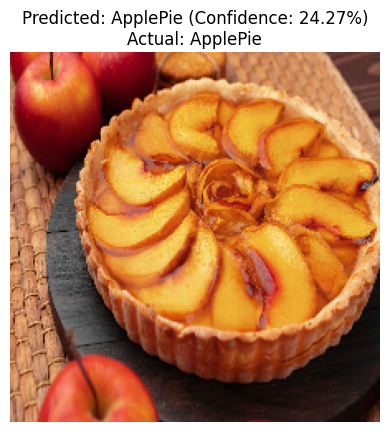

In [43]:
import matplotlib.pyplot as plt

# Specify the path to the image
img_path = "/content/drive/MyDrive/Colab Notebooks/food-11/test/0_A020511XX_02587.jpg"

# Load and preprocess the image
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = img_array / 255.0  # Rescale

# Make a prediction
predictions = model.predict(img_array)
predicted_class = np.argmax(predictions)
confidence = predictions[0][predicted_class]

# Extract the actual label from the filename
actual_label = int(img_path.split("/")[-1].split("_")[0])

# Map class indices to class names
class_names = ['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']

# Display the results
plt.imshow(img)
plt.title(f"Predicted: {class_names[predicted_class]} (Confidence: {confidence*100:.2f}%)\nActual: {class_names[actual_label]}")
plt.axis('off')
plt.show()


1/1 [==============================] - 0s 90ms/step


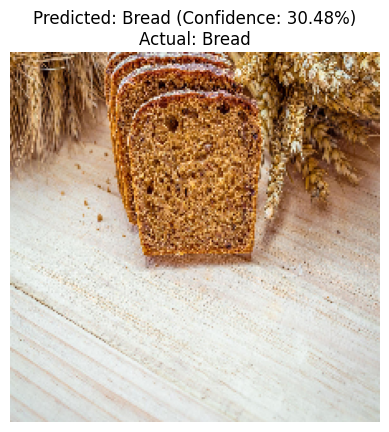

In [44]:
import matplotlib.pyplot as plt

# Specify the path to the image
img_path = "/content/drive/MyDrive/Colab Notebooks/food-11/test/3_A020118XX_10935.jpg"

# Load and preprocess the image
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = img_array / 255.0  # Rescale

# Make a prediction
predictions = model.predict(img_array)
predicted_class = np.argmax(predictions)
confidence = predictions[0][predicted_class]

# Extract the actual label from the filename
actual_label = int(img_path.split("/")[-1].split("_")[0])

# Map class indices to class names
class_names = ['ApplePie', 'BagelSandwich', 'Bibimbop', 'Bread', 'FriedRice', 'Pork']

# Display the results
plt.imshow(img)
plt.title(f"Predicted: {class_names[predicted_class]} (Confidence: {confidence*100:.2f}%)\nActual: {class_names[actual_label]}")
plt.axis('off')
plt.show()


#### Implementing amother Iteration for the data augmentation

In [52]:
history = model.fit(datagen.flow(train_x, y_train, batch_size=8),
                    validation_data=(val_x, y_val),
                    epochs=40,
                    callbacks=[ModelCheckpoint('1vgg19_finetuned.h5', save_best_only=True)])

Epoch 1/40
44/44 [==============================] - 13s 225ms/step - loss: 2.7839 - accuracy: 0.7225 - val_loss: 0.6103 - val_accuracy: 0.8800
Epoch 2/40
44/44 [==============================] - 7s 153ms/step - loss: 3.6552 - accuracy: 0.6936 - val_loss: 0.4365 - val_accuracy: 0.8700
Epoch 3/40
44/44 [==============================] - 5s 122ms/step - loss: 3.2506 - accuracy: 0.7283 - val_loss: 0.8063 - val_accuracy: 0.8900
Epoch 4/40
44/44 [==============================] - 5s 118ms/step - loss: 3.4724 - accuracy: 0.7341 - val_loss: 0.6431 - val_accuracy: 0.9000
Epoch 5/40
44/44 [==============================] - 5s 120ms/step - loss: 2.9416 - accuracy: 0.7601 - val_loss: 1.0261 - val_accuracy: 0.8900
Epoch 6/40
44/44 [==============================] - 6s 138ms/step - loss: 3.9052 - accuracy: 0.7254 - val_loss: 1.3093 - val_accuracy: 0.8600
Epoch 7/40
44/44 [==============================] - 5s 121ms/step - loss: 3.9857 - accuracy: 0.7023 - val_loss: 0.8024 - val_accuracy: 0.8700
Epoch

### Test scorces here is 90% 😀

In [53]:
loss, accuracy = model.evaluate(test_x, y_test)
print(f"Test Loss: {loss}")
print(f"Test Accuracy: {accuracy}")


2/2 [==============================] - 0s 151ms/step - loss: 1.2642 - accuracy: 0.9038
Test Loss: 1.2641648054122925
Test Accuracy: 0.9038461446762085


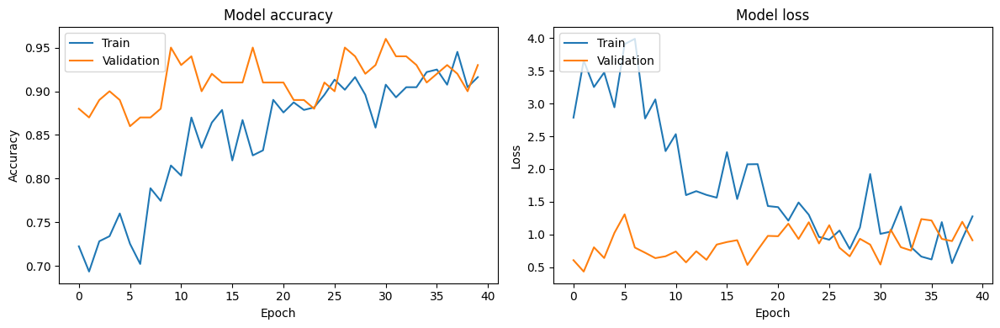

In [54]:
import matplotlib.pyplot as plt

# Plot training & validation accuracy values
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

plt.tight_layout()
plt.show()


#The End 🔚  Thank you for journeyung with me 😀